<a href="https://colab.research.google.com/github/harshsilori/AnalystSpot/blob/master/blinkdetection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
!pip install pyqt5


     |████████████████████████████████| 61.2MB 1.3MB/s 
     |████████████████████████████████| 71kB 16.4MB/s 


30
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy

/usr/local/lib/python3.6/dist-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


0.3143352242399967
Total blink 0
Counter   140
<class 'numpy.ndarray'>
Total number of face detected==>  1
0.3103724464191206
Total blink 0
Counter   141
<class 'numpy.ndarray'>
Total number of face detected==>  1
0.30347591817091996
Total blink 0
Counter   142
<class 'numpy.ndarray'>
Total number of face detected==>  1
0.3036195462473239
Total blink 0
Counter   143
<class 'numpy.ndarray'>
Total number of face detected==>  1
0.2974834614732524
Total blink 0
Counter   144
<class 'numpy.ndarray'>
Total number of face detected==>  1
0.2959026732391353
Total blink 0
Counter   145
<class 'numpy.ndarray'>
Total number of face detected==>  1
0.28167318479341047
Total blink 0
Counter   146
<class 'numpy.ndarray'>
Total number of face detected==>  1
0.2975257204203882
Total blink 0
Counter   147
<class 'numpy.ndarray'>
Total number of face detected==>  1
0.2928923314236327
Total blink 0
Counter   148
<class 'numpy.ndarray'>
Total number of face detected==>  1
0.2807262150964408
Total blink 0
Co

InvalidImage: ignored

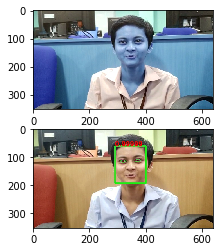

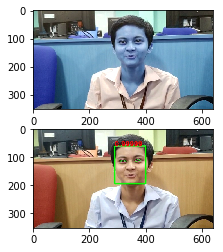

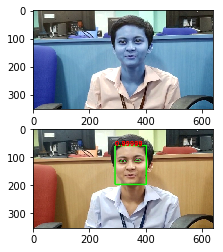

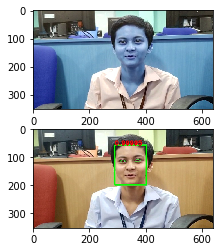

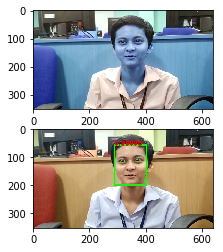

...

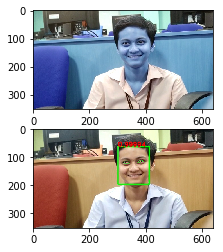

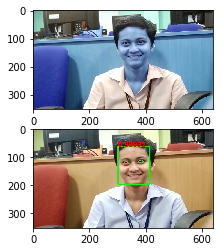

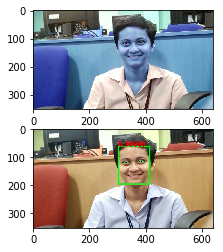

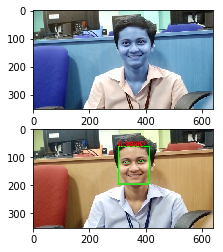

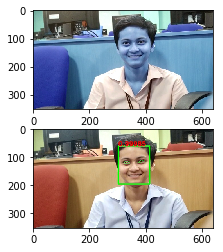

Buffered data was truncated after reaching the output size limit.

In [1]:
import cv2
import matplotlib.pyplot as plt 
import matplotlib.image as mpimg
from mtcnn.mtcnn import MTCNN
import numpy as np
from scipy.spatial import distance
from imutils import face_utils
import imutils
import dlib

blink_thresh = 3
total_blink = 0
blink_count = 0 

def eye_aspect_ratio(eye):
                A = distance.euclidean(eye[1], eye[5])
                B = distance.euclidean(eye[2], eye[4])
                C = distance.euclidean(eye[0], eye[3])
                ear = (A + B) / (2.0 * C)
                return ear

def detect_face(original_frame):
  
    detector = MTCNN()
    original_image = cv2.imread(original_frame)
    resultant_json_object = detector.detect_faces(original_image)
#     print(resultant_json_object)
    duplicate_image=original_image.copy()
    
    index=len(resultant_json_object)
    print("Total number of face detected==> ",index)                  #It'll display count of total face detected. i.e total number of bounding_boxes found
    
    if(index==0):
      print("No face detected.")
      return ;
    

    for i in range(0,index):
      bounding_box = resultant_json_object[i]['box']
      keypoints = resultant_json_object[i]['keypoints']
      confidence=resultant_json_object[i]['confidence']   #accuracy of detected face
      cv2.rectangle(original_image,(bounding_box[0],bounding_box[1]),(bounding_box[0]+bounding_box[2], bounding_box[1] + bounding_box[3]),(0,255,0),3)
#       cv2.circle(original_image,(keypoints['left_eye']), 2, (0,155,255), 2)
#       cv2.circle(original_image,(keypoints['right_eye']), 2, (0,155,255), 2)
#       cv2.circle(original_image,(keypoints['nose']), 2, (0,155,255), 2)
#       cv2.circle(original_image,(keypoints['mouth_left']), 2, (0,155,255), 2)
#       cv2.circle(original_image,(keypoints['mouth_right']), 2, (0,155,255), 2)

      font = cv2.FONT_HERSHEY_DUPLEX 
      cv2.putText(original_image, str(confidence)[0:7], (bounding_box[0],bounding_box[1]), font,0.75, (0, 0,255),2)
      cv2.imwrite("Face_detected_image.jpg", original_image)

    pupil_detect("Face_detected_image.jpg",duplicate_image)

  
def pupil_detect(Face_detected_image,duplicate_image):
  
  global total_blink
  global blink_count 

  
  Face_detected_frame=cv2.imread(Face_detected_image)
  thresh = 0.25                           #if ear is less than threshold value then eyes are considered as closed
#   frame_check = 20
  detect = dlib.get_frontal_face_detector()        #return object for face detection          
  predict = dlib.shape_predictor("shape_predictor_68_face_landmarks.dat")
  # print(predict)
  (lStart, lEnd) = face_utils.FACIAL_LANDMARKS_IDXS["left_eye"]
  (rStart, rEnd) = face_utils.FACIAL_LANDMARKS_IDXS["right_eye"]  


  # frame = imutils.resize(frame, width=650)
  gray_image = cv2.cvtColor(Face_detected_frame, cv2.COLOR_BGR2GRAY)
  subjects = detect(gray_image, 0)
  
#   for i, d in enumerate(subjects):
#     print("Detection {}: Left: {} Top: {} Right: {} Bottom: {}".format(
#             i, d.left(), d.top(), d.right(), d.bottom()))
#   print("after pupil detect",subjects)
#   print("Total faces in which pupil can be detected==>",len(subjects))
  if(len(subjects)==0):
    print("Eyes not detected")
    return;
  f, ax1=plt.subplots(2,1)
  for subject in subjects:
    shape = predict(gray_image, subject)
    shape = face_utils.shape_to_np(shape)          #converting to NumPy Array
    leftEye = shape[lStart:lEnd]
    rightEye = shape[rStart:rEnd]
#     print("leftEye co-ordinates ",leftEye,sep='\n')
#     print("rightEye co-ordinates",rightEye,sep='\n')
    
    leftEyeXMid=(leftEye[1][0]+leftEye[5][0]+leftEye[2][0]+leftEye[4][0])//4
    leftEyeYMid=(leftEye[1][1]+leftEye[5][1]+leftEye[2][1]+leftEye[4][1])//4

    rightEyeXMid=(rightEye[1][0]+rightEye[5][0]+rightEye[2][0]+rightEye[4][0])//4
    rightEyeYMid=(rightEye[1][1]+rightEye[5][1]+rightEye[2][1]+rightEye[4][1])//4

  #   print(leftEye[1][0],leftEye[1][1])
  #   print(leftEye[5][0],leftEye[5][1])
  #   print(leftEye[2][0],leftEye[2][1])
  #   print(leftEye[4][0],leftEye[4][1])
  #   print(leftEyeXMid)
  #   print(leftEyeYMid)
  
    leftEAR = eye_aspect_ratio(leftEye)
    rightEAR = eye_aspect_ratio(rightEye)
    ear = (leftEAR + rightEAR) / 2.0
    
    print(ear)
  #   print("left ear", leftEAR)
  #   print("right ear", rightEAR)
  #   print(leftEye)
    leftEyeHull = cv2.convexHull(leftEye)
    rightEyeHull = cv2.convexHull(rightEye)
#     print(leftEyeHull)
    cv2.drawContours(Face_detected_frame, [leftEyeHull], -1, (0, 255, 0), 1)
    cv2.drawContours(Face_detected_frame, [rightEyeHull], -1, (0, 255, 0), 1)
   
    
    if ear < thresh:                          #To check whether eyes are closed or not
      
      cv2.putText(Face_detected_frame, "****************Eyes Closed!****************", (10, 30),
          cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 0, 255), 2)
      
      blink_count= blink_count+1
      if(blink_count==blink_thresh):
        total_blink+=1
      
    else:
      blink_count=0
      cv2.circle(Face_detected_frame,(leftEyeXMid,leftEyeYMid), 1, (0,155,255), 1)
      cv2.circle(Face_detected_frame,(rightEyeXMid,rightEyeYMid), 1, (0,155,255), 1)
  # cv2.imshow("Frame", frame)
  
  cv2.imwrite("Pupil_detected_image.jpg",Face_detected_frame)
  img_pupil=mpimg.imread('Pupil_detected_image.jpg')
  ax1[0].imshow(duplicate_image)
  ax1[1].imshow(img_pupil)
  

vidcap = cv2.VideoCapture("check1.mp4")
count=0
success = True
fps = int(vidcap.get(cv2.CAP_PROP_FPS))
print(fps)

while success:
    success,image = vidcap.read()
    print(type(image))
#     image = imutils.resize(image, width=650,height=650)
#     print('read a new frame:',success)
    if(count>=120):
#      
      cv2.imwrite("original_frame.jpg", image)
      detect_face("original_frame.jpg")
      print("Total blink", total_blink)
      print("Counter  ",count)
#       detect_face("danny.png")
#       break;
    
#     if count%(10*fps) == 0 :
#          cv2.imwrite('frame%d.jpg'%count,image)
#          print('successfully written 10th frame')
#     count+=1
#     cv2.imwrite("frame%d.jpg" % count, image)     # save frame as JPEG file
#     cv2.waitKey(2)
    count += 1

print("Total blink", total_blink)
print("Successfully Processed!")

